In [1]:
# install dependencies: 
!pip install pyyaml==5.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

     |████████████████████████████████| 276kB 23.6MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp36-cp36m-linux_x86_64.whl size=44075 sha256=8060ed84f4a59d9a5409fcb884d5e5ab190ba55466ecd3c6e353f2b17dbb50b0
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
1.7.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [2]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.7)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
import torch

assert torch.__version__.startswith("1.7")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
     |████████████████████████████████| 6.8MB 611kB/s 
     |████████████████████████████████| 2.2MB 17.7MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.2.post20201111-cp36-none-any.whl size=44418 sha256=61e5ae995fda20babc7bbc8e35723b091fb1c3818481e62a7796466aa7594a21
  Stored in directory: /root/.cache/pip/wheels/70/d9/52/49a17f0d21e723c371c4a3f60138545e0a4163c5f7ff42c855
Successfully built fvcore
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling Pillow-7.0.0:
      Successfully uninstalled Pillow-7.0.0


In [1]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [2]:
!wget http://host.robots.ox.ac.uk/pascal/VOC/voc2007/VOCtrainval_06-Nov-2007.tar

--2020-11-20 01:48:54--  http://host.robots.ox.ac.uk/pascal/VOC/voc2007/VOCtrainval_06-Nov-2007.tar
Resolving host.robots.ox.ac.uk (host.robots.ox.ac.uk)... 129.67.94.152
Connecting to host.robots.ox.ac.uk (host.robots.ox.ac.uk)|129.67.94.152|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 460032000 (439M) [application/x-tar]
Saving to: ‘VOCtrainval_06-Nov-2007.tar’

VOCtrainval_06-Nov- 100%[===================>] 438.72M  15.5MB/s    in 29s     

2020-11-20 01:49:24 (15.0 MB/s) - ‘VOCtrainval_06-Nov-2007.tar’ saved [460032000/460032000]



In [3]:
!tar -xvf VOCtrainval_06-Nov-2007.tar
#!tar -vxf '/content/drive/My Drive/HW6/VOCtrainval_06-Nov-2007.tar'

Streaming output truncated to the last 5000 lines.
VOCdevkit/VOC2007/JPEGImages/001732.jpg
VOCdevkit/VOC2007/JPEGImages/001733.jpg
VOCdevkit/VOC2007/JPEGImages/001734.jpg
VOCdevkit/VOC2007/JPEGImages/001738.jpg
VOCdevkit/VOC2007/JPEGImages/001739.jpg
VOCdevkit/VOC2007/JPEGImages/001741.jpg
VOCdevkit/VOC2007/JPEGImages/001746.jpg
VOCdevkit/VOC2007/JPEGImages/001747.jpg
VOCdevkit/VOC2007/JPEGImages/001749.jpg
VOCdevkit/VOC2007/JPEGImages/001750.jpg
VOCdevkit/VOC2007/JPEGImages/001752.jpg
VOCdevkit/VOC2007/JPEGImages/001754.jpg
VOCdevkit/VOC2007/JPEGImages/001755.jpg
VOCdevkit/VOC2007/JPEGImages/001756.jpg
VOCdevkit/VOC2007/JPEGImages/001758.jpg
VOCdevkit/VOC2007/JPEGImages/001759.jpg
VOCdevkit/VOC2007/JPEGImages/001761.jpg
VOCdevkit/VOC2007/JPEGImages/001765.jpg
VOCdevkit/VOC2007/JPEGImages/001766.jpg
VOCdevkit/VOC2007/JPEGImages/001768.jpg
VOCdevkit/VOC2007/JPEGImages/001771.jpg
VOCdevkit/VOC2007/JPEGImages/001772.jpg
VOCdevkit/VOC2007/JPEGImages/001775.jpg
VOCdevkit/VOC2007/JPEGImages/

In [4]:
!mv VOCdevkit datasets

In [5]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.OUTPUT_DIR = 'MyVOCTraining'
cfg.DATASETS.TRAIN = ("voc_2007_train",)  
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 1
cfg.MODEL.WEIGHTS =model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml") # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 1
cfg.SOLVER.BASE_LR = 0.00025 # pick a good LR
cfg.SOLVER.MAX_ITER = 3000
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 20



In [ ]:
## Fine tune

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.OUTPUT_DIR = 'MyVOCTraining'
cfg.DATASETS.TRAIN = ("voc_2007_train",)  
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 1
cfg.MODEL.WEIGHTS =model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml") # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 1
cfg.SOLVER.BASE_LR = 0.00025 # pick a good LR
cfg.SOLVER.MAX_ITER = 3000
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 20



In [2]:
## fine tune model 2
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.OUTPUT_DIR = 'MyVOCTraining'
cfg.DATASETS.TRAIN = ("voc_2007_train",)  
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 1
cfg.MODEL.WEIGHTS =model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml") # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 1
cfg.SOLVER.BASE_LR = 0.0001 # pick a good LR
cfg.SOLVER.MAX_ITER = 5000
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 20

In [3]:
from detectron2.engine import DefaultTrainer
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[11/20 03:14:58 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (21, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (21,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (80, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (80,) in the model! You might want to double check if this is expected.


[11/20 03:15:00 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:217: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  num_fg = fg_inds.nonzero().numel()


[11/20 03:15:05 d2.utils.events]:  eta: 0:16:44  iter: 19  total_loss: 3.781  loss_cls: 3.188  loss_box_reg: 0.6524  loss_rpn_cls: 0.01579  loss_rpn_loc: 0.01402  time: 0.2023  data_time: 0.0071  lr: 1.9981e-06  max_mem: 1439M
[11/20 03:15:09 d2.utils.events]:  eta: 0:16:49  iter: 39  total_loss: 3.778  loss_cls: 3.183  loss_box_reg: 0.5054  loss_rpn_cls: 0.01184  loss_rpn_loc: 0.0154  time: 0.2036  data_time: 0.0021  lr: 3.9961e-06  max_mem: 1511M
[11/20 03:15:13 d2.utils.events]:  eta: 0:16:57  iter: 59  total_loss: 3.518  loss_cls: 3.076  loss_box_reg: 0.3946  loss_rpn_cls: 0.009593  loss_rpn_loc: 0.01222  time: 0.2084  data_time: 0.0021  lr: 5.9941e-06  max_mem: 1511M
[11/20 03:15:17 d2.utils.events]:  eta: 0:16:55  iter: 79  total_loss: 3.378  loss_cls: 2.916  loss_box_reg: 0.4521  loss_rpn_cls: 0.006303  loss_rpn_loc: 0.006794  time: 0.2082  data_time: 0.0021  lr: 7.9921e-06  max_mem: 1511M
[11/20 03:15:21 d2.utils.events]:  eta: 0:16:51  iter: 99  total_loss: 3.197  loss_cls: 2.

In [ ]:
## fine tune

from detectron2.engine import DefaultTrainer
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[11/18 20:38:29 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_280758.pkl: 167MB [00:08, 20.4MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (21, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (21,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (80, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (80,) in the model! You might want to double check if this is expected.


[11/18 20:38:43 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:217: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  num_fg = fg_inds.nonzero().numel()


[11/18 20:38:47 d2.utils.events]:  eta: 0:09:27  iter: 19  total_loss: 4.067  loss_cls: 3.092  loss_box_reg: 0.9438  loss_rpn_cls: 0.007895  loss_rpn_loc: 0.01028  time: 0.1917  data_time: 0.0076  lr: 4.9953e-06  max_mem: 1503M
[11/18 20:38:50 d2.utils.events]:  eta: 0:09:04  iter: 39  total_loss: 3.998  loss_cls: 3.028  loss_box_reg: 0.9105  loss_rpn_cls: 0.007903  loss_rpn_loc: 0.01845  time: 0.1860  data_time: 0.0019  lr: 9.9902e-06  max_mem: 1503M
[11/18 20:38:54 d2.utils.events]:  eta: 0:09:15  iter: 59  total_loss: 3.841  loss_cls: 2.824  loss_box_reg: 0.9729  loss_rpn_cls: 0.009414  loss_rpn_loc: 0.01114  time: 0.1880  data_time: 0.0019  lr: 1.4985e-05  max_mem: 1503M
[11/18 20:38:58 d2.utils.events]:  eta: 0:09:12  iter: 79  total_loss: 3.549  loss_cls: 2.532  loss_box_reg: 1.008  loss_rpn_cls: 0.0129  loss_rpn_loc: 0.0075  time: 0.1892  data_time: 0.0019  lr: 1.998e-05  max_mem: 1510M
[11/18 20:39:02 d2.utils.events]:  eta: 0:09:11  iter: 99  total_loss: 3.279  loss_cls: 2.287

In [ ]:
## fine tune model 2

from detectron2.engine import DefaultTrainer
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[11/18 21:34:39 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (21, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (21,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (80, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (80,) in the model! You might want to double check if this is expected.


[11/18 21:34:39 d2.engine.train_loop]: Starting training from iteration 0
[11/18 21:34:44 d2.utils.events]:  eta: 0:14:38  iter: 19  total_loss: 3.632  loss_cls: 3.054  loss_box_reg: 0.4925  loss_rpn_cls: 0.01334  loss_rpn_loc: 0.01633  time: 0.2212  data_time: 0.0060  lr: 4.9953e-06  max_mem: 1785M
[11/18 21:34:48 d2.utils.events]:  eta: 0:14:26  iter: 39  total_loss: 3.205  loss_cls: 2.912  loss_box_reg: 0.2165  loss_rpn_cls: 0.01058  loss_rpn_loc: 0.0125  time: 0.2215  data_time: 0.0020  lr: 9.9902e-06  max_mem: 1785M
[11/18 21:34:52 d2.utils.events]:  eta: 0:14:18  iter: 59  total_loss: 2.851  loss_cls: 2.647  loss_box_reg: 0.2198  loss_rpn_cls: 0.008341  loss_rpn_loc: 0.005667  time: 0.2189  data_time: 0.0020  lr: 1.4985e-05  max_mem: 1785M
[11/18 21:34:57 d2.utils.events]:  eta: 0:14:27  iter: 79  total_loss: 2.588  loss_cls: 2.248  loss_box_reg: 0.3433  loss_rpn_cls: 0.01621  loss_rpn_loc: 0.01147  time: 0.2243  data_time: 0.0020  lr: 1.998e-05  max_mem: 1785M
[11/18 21:35:02 d2

In [7]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir '/content/MyVOCTraining'

<IPython.core.display.Javascript object>

In [ ]:
## Fine tune

# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir '/content/MyVOCTraining'

<IPython.core.display.Javascript object>

In [ ]:
## FINE TUNE MODEL 2
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir '/content/MyVOCTraining'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 266), started 1:01:29 ago. (Use '!kill 266' to kill it.)

<IPython.core.display.Javascript object>

In [4]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

In [ ]:
## Fine tune
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

In [ ]:
## Fine tune MODEL 2
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

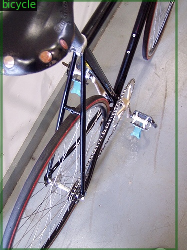

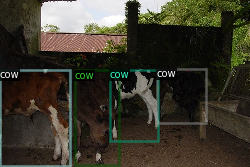

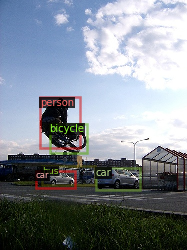

In [9]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("voc_2007_val")
my_metadata = MetadataCatalog.get("voc_2007_val")
#dataset_dicts = get_balloon_dicts("VOC2007/val")
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=my_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    #out = v.draw_dataset_dict_predictions(outputs["dataset_dict"].to("cpu"))
    out= v.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

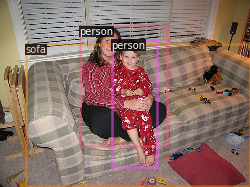

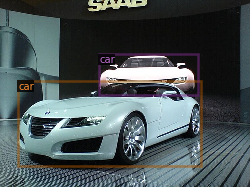

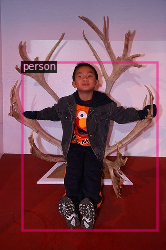

In [5]:
## Fine tune
from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("voc_2007_val")
my_metadata = MetadataCatalog.get("voc_2007_val")
#dataset_dicts = get_balloon_dicts("VOC2007/val")
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=my_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    #out = v.draw_dataset_dict_predictions(outputs["dataset_dict"].to("cpu"))
    out= v.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

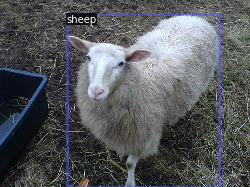

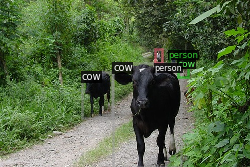

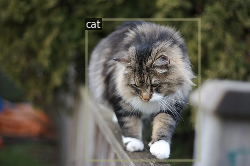

In [ ]:
## Fine tune MODEL2
from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("voc_2007_val")
my_metadata = MetadataCatalog.get("voc_2007_val")
#dataset_dicts = get_balloon_dicts("VOC2007/val")
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=my_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    #out = v.draw_dataset_dict_predictions(outputs["dataset_dict"].to("cpu"))
    out= v.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])





from detectron2.utils.visualizer import ColorMode, Visualizer

v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [1]:
from detectron2.utils.visualizer import ColorMode, Visualizer

v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

ModuleNotFoundError: ignored

In [6]:
from detectron2.evaluation import PascalVOCDetectionEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = PascalVOCDetectionEvaluator("voc_2007_val")
val_loader = build_detection_test_loader(cfg, "voc_2007_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

[11/20 03:33:13 d2.data.build]: Distribution of instances among all 20 categories:
|  category   | #instances   |  category   | #instances   |  category  | #instances   |
|:-----------:|:-------------|:-----------:|:-------------|:----------:|:-------------|
|  aeroplane  | 175          |   bicycle   | 216          |    bird    | 305          |
|    boat     | 190          |   bottle    | 296          |    bus     | 141          |
|     car     | 818          |     cat     | 198          |   chair    | 706          |
|     cow     | 171          | diningtable | 162          |    dog     | 267          |
|    horse    | 199          |  motorbike  | 197          |   person   | 2742         |
| pottedplant | 320          |    sheep    | 162          |    sofa    | 207          |
|    train    | 170          |  tvmonitor  | 176          |            |              |
|    total    | 7818         |             |              |            |              |
[11/20 03:33:13 d2.data.dataset_mappe

In [7]:
## Fine tune
from detectron2.evaluation import PascalVOCDetectionEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = PascalVOCDetectionEvaluator("voc_2007_val")
val_loader = build_detection_test_loader(cfg, "voc_2007_val")
print(inference_on_dataset(trainer.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

[11/20 03:37:58 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[11/20 03:37:58 d2.data.common]: Serializing 2510 elements to byte tensors and concatenating them all ...
[11/20 03:37:58 d2.data.common]: Serialized dataset takes 1.14 MiB
[11/20 03:37:58 d2.evaluation.evaluator]: Start inference on 2510 images
[11/20 03:37:59 d2.evaluation.evaluator]: Inference done 11/2510. 0.1098 s / img. ETA=0:04:37
[11/20 03:38:04 d2.evaluation.evaluator]: Inference done 57/2510. 0.1087 s / img. ETA=0:04:30
[11/20 03:38:09 d2.evaluation.evaluator]: Inference done 103/2510. 0.1090 s / img. ETA=0:04:25
[11/20 03:38:14 d2.evaluation.evaluator]: Inference done 148/2510. 0.1095 s / img. ETA=0:04:22
[11/20 03:38:19 d2.evaluation.evaluator]: Inference done 193/2510. 0.1101 s / img. ETA=0:04:18
[11/20 03:38:24 d2.evaluation.evaluator]: Inference done 238/2510. 0.1103 s / img. ETA=0:04:13
[11/20 

In [ ]:
## Fine tune MODEL 2
from detectron2.evaluation import PascalVOCDetectionEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = PascalVOCDetectionEvaluator("voc_2007_val")
val_loader = build_detection_test_loader(cfg, "voc_2007_val")
print(inference_on_dataset(trainer.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

[11/18 21:52:32 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[11/18 21:52:32 d2.data.common]: Serializing 2510 elements to byte tensors and concatenating them all ...
[11/18 21:52:32 d2.data.common]: Serialized dataset takes 1.14 MiB
[11/18 21:52:32 d2.evaluation.evaluator]: Start inference on 2510 images
[11/18 21:52:34 d2.evaluation.evaluator]: Inference done 11/2510. 0.1155 s / img. ETA=0:04:51
[11/18 21:52:39 d2.evaluation.evaluator]: Inference done 55/2510. 0.1141 s / img. ETA=0:04:43
[11/18 21:52:44 d2.evaluation.evaluator]: Inference done 99/2510. 0.1144 s / img. ETA=0:04:39
[11/18 21:52:49 d2.evaluation.evaluator]: Inference done 142/2510. 0.1151 s / img. ETA=0:04:35
[11/18 21:52:54 d2.evaluation.evaluator]: Inference done 185/2510. 0.1157 s / img. ETA=0:04:32
[11/18 21:52:59 d2.evaluation.evaluator]: Inference done 227/2510. 0.1163 s / img. ETA=0:04:28
[11/18 2

In [ ]:
cfg= get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_C4_3x.yaml"))
cfg.OUTPUT_DIR = 'MyVOCTraining_model'
cfg.DATASETS.TRAIN = ("voc_2007_train",)  
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 1
cfg.MODEL.WEIGHTS =model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_C4_3x.yaml") # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 1
cfg.SOLVER.BASE_LR = 0.00025 # pick a good LR
cfg.SOLVER.MAX_ITER = 3000
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 20



In [ ]:
from detectron2.engine import DefaultTrainer
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[11/18 19:49:24 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): ResNet(
    (stem): BasicStem(
      (conv1): Conv2d(
        3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
        (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
      )
    )
    (res2): Sequential(
      (0): BottleneckBlock(
        (shortcut): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
        )
        (conv1): Conv2d(
          64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv2): Conv2d(
          64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv3): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
 

model_final_f97cb7.pkl: 136MB [00:06, 20.7MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 2048) in the checkpoint but (21, 2048) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (21,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 2048) in the checkpoint but (80, 2048) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (80,) in the model! You might want to double check if this is expected.


[11/18 19:49:31 d2.engine.train_loop]: Starting training from iteration 0
[11/18 19:49:37 d2.utils.events]:  eta: 0:14:18  iter: 19  total_loss: 4.232  loss_cls: 3.068  loss_box_reg: 0.9959  loss_rpn_cls: 0.06952  loss_rpn_loc: 0.09491  time: 0.2897  data_time: 0.0066  lr: 4.9953e-06  max_mem: 1619M
[11/18 19:49:43 d2.utils.events]:  eta: 0:14:20  iter: 39  total_loss: 4.104  loss_cls: 2.942  loss_box_reg: 0.9798  loss_rpn_cls: 0.105  loss_rpn_loc: 0.1054  time: 0.2927  data_time: 0.0022  lr: 9.9902e-06  max_mem: 1619M
[11/18 19:49:49 d2.utils.events]:  eta: 0:14:32  iter: 59  total_loss: 3.819  loss_cls: 2.727  loss_box_reg: 0.9395  loss_rpn_cls: 0.08873  loss_rpn_loc: 0.09588  time: 0.2953  data_time: 0.0022  lr: 1.4985e-05  max_mem: 1619M
[11/18 19:49:55 d2.utils.events]:  eta: 0:14:31  iter: 79  total_loss: 3.459  loss_cls: 2.44  loss_box_reg: 0.9453  loss_rpn_cls: 0.0607  loss_rpn_loc: 0.05515  time: 0.2969  data_time: 0.0022  lr: 1.998e-05  max_mem: 1619M
[11/18 19:50:01 d2.utils